# **END TO END, MULTI-CLASSS, TRAFFIC SIGNAL CLASSIFIER** ⭕⛔🚏🚧🚳🚷🛑

 ---
 🔵🔵🔵🔵 **Introduction** 🔵🔵🔵🔵
 
 This notebook makes an end to end, multi class image classifier using **TensorFlow 2.0** and **TensorFlow Hub**.

**1. Problem**:
Identifying the kind of traffic sign from given sign image.

**2. Data:**
The data we are using is collected by me from various sources available online, i.e. via Bing search and also common looking traffic signs of other countries are also added in this dataset, and the dataset now has only those signs that are India specific. 

**3. Evaluation:**


**4. Features:**
Some information about the data,
> * we are dealing with images (unstructured data) , so it's best we use deep learning or transfer learning.
> * there are 85 types of traffic signs (this means there are 85 different classes).
> * there are total ~~5193~~ 7210 labeled images in total.





---

🔴🔴🔴🔴 **Problems raised during previous meeting** 🔴🔴🔴🔴



1. Visit `beautiful soup` for data gathering instead of manual data collection. 😐
2. Increase data by data augmentation like croping, rotating and tilting etc. 😐
3. Show what is the accuracy. ✅
4. Keep track of the older accuracy obtained, whenever a model is trained again. ✅
5. Find where the model is confused betweeen labels. ✅



---

🟠🟠🟠🟠 **Future plans/Improvement** 🟠🟠🟠🟠

1. Want to convert it into a **self supervised** classification problem.
2. As the probability of some traffic signs being together in a picture is high, so want to convert this existing single label classification into a **multi label classification**. 

---

🟡🟡🟡🟡 **List of functions created** 🟡🟡🟡🟡

1. **`process_image()`** 

> reads in an image file, turns the jpg into a tensor with 3 channel (RGB), convert the colour channel values from 0-255 to 0-1, resizes the image to our desired value(224,224)
>* Input: an image_path and final image size
>* output: modified image   

2. **`get_image_label()`**

> to use TensorFlow effectively, data should be in form of tensor tuples (image, label). 
>* Input: an image_path and corresponding label
>* Output: a tensor tuple like (Image, label)

3. **`create_data_batches()`** 

> create batches of data out of image and label pairs, shuffles the data if it's training data but doesnt shuffle if it's validation data. also accepts test data as input(no label)
>* Input: X, y, batch_size(32)   

4. **`show_25_images()`**

> helps to visualise a data batch by displaying a plot of 25 images with label from their data batch

5. **`create_model()` **

> builds a keras model by setting the model layers, compiling the model, builds and return the model
>* Input: input_shape(224,224,3), output_shape(85), model_url
>* Output: model

6. **`create_tensorboard_callbacks()`**

> create a log directory for storing tensorboard logs

7. **`train_model()`**

> trains a given model and returns a trained version

8. **`get_pred_label()`**

>turns an array of prediction probabilities into a label

9. **`unbatchify()`**

> takes a batched dataset of (image, label) tensors and returns seperate array of images and labels

10. **`plot_pred()`**

> display the prediction, ground truth and image for the sample n. if prediction is true the label will be green colored and red otherwise

11. **`plot_pred_conf()`**

> plot the top 10 highest prediction confidences along with the true labels for sample n. correct label will be in green  

12. **`save_model()`**

> saves a given model in the model's directory and appends a suffix(string)

13. **`load_model()`**

> load a saved model from a specified path
---


## Getting our workspace ready🟩🟪
* import tensorflow ✔
* import tensorflow hub ✔
* make sure we are using a GPU ✔

In [ ]:
# Import TensorFlow into Colab🟩🟪
import tensorflow as tf
import tensorflow_hub as hub
print("TF version :",tf.__version__)
print("TF_Hub version :",hub.__version__)

# check for GPU availability
print("GPU","available (YES!!!!)" if tf.config.list_physical_devices("GPU") else "Unavailable :(")

TF version : 2.7.0
TF_Hub version : 0.12.0
GPU available (YES!!!!)


## Getting our data ready( Turning into tensors)
With all machine learning models our data has to be in numerical format. So that's what we will be doing first, turning our images into Tensors (Numerical Representation).

lets start by accessing our data and checking our labels

In [ ]:
# checkout the labels of our data 🟩
import pandas as pd
labels_excel = pd.read_excel("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/traffic_labels.xlsx")
print(labels_excel.head(50000))
print()
print()
print(labels_excel.describe())


          ID                  TRAFFIC_SIGN
0     a00000  ALL MOTOR VEHICLE PROHIBITED
1      00001  ALL MOTOR VEHICLE PROHIBITED
2      00002  ALL MOTOR VEHICLE PROHIBITED
3      00003  ALL MOTOR VEHICLE PROHIBITED
4      00004  ALL MOTOR VEHICLE PROHIBITED
...      ...                           ...
7205   84030                Y INTERSECTION
7206   84031                Y INTERSECTION
7207   84032                Y INTERSECTION
7208   84033                Y INTERSECTION
7209   84034                Y INTERSECTION

[7210 rows x 2 columns]


           ID    TRAFFIC_SIGN
count    7210            7210
unique   7210              85
top     47008  SPEED LIMIT 40
freq        1             481


In [ ]:
# Mount google drive 🟩
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


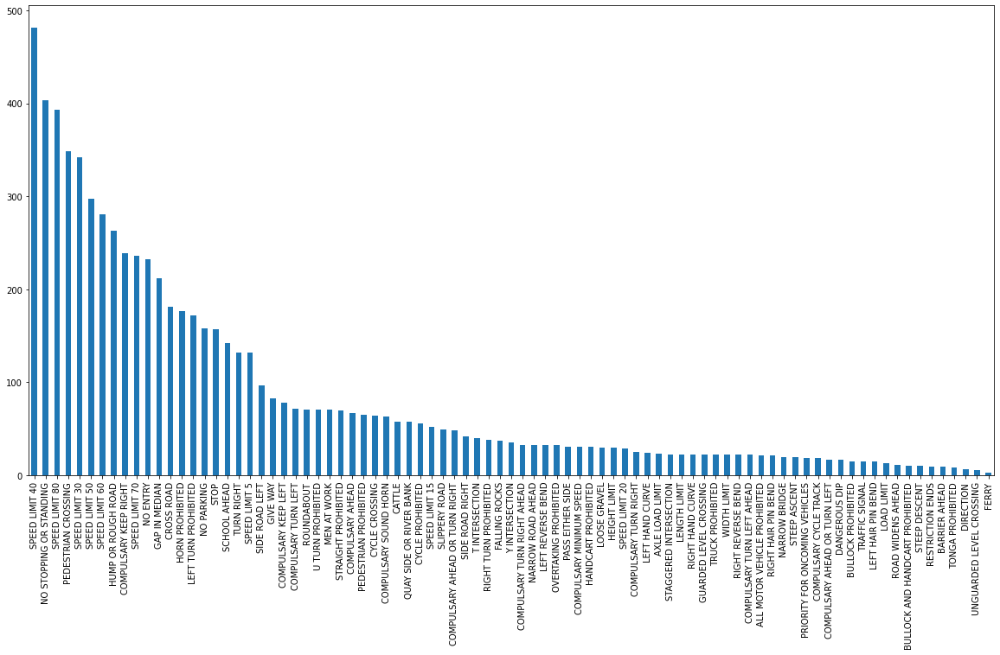

In [ ]:
# how many images are there of each kind🟪
labels_excel["TRAFFIC_SIGN"].value_counts().plot.bar(figsize=(20,10))

In [ ]:
print(labels_excel.value_counts("TRAFFIC_SIGN").median())

35.0


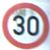

In [ ]:
# Lets view an image 🟩
from IPython.display import Image
Image("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/65317.jpg")

## Getting images and their labels
let's get the list of all our image file path names.

In [ ]:
# create pathnames from image id's 🟩
filenames = ["drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/"+fname+".jpg" for fname in labels_excel["ID"]]

#check first 10 filenames
filenames[:]

['drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/a00000.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00001.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00002.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00003.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00004.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00005.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00006.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00007.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00008.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00009.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/00010.jpg',
 'drive/M

In [ ]:
#check whether the number of filenames equals the number of actual images 🟩
import os
if len(os.listdir("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/")) == len(filenames) :
  print("filenames matches actual amount of files. Proceed.")
else:
  print("filenames doesn't match the amount of files. check the target directory")  

filenames matches actual amount of files. Proceed.


In [ ]:
len(filenames)

7210

In [ ]:
len(os.listdir("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg/"))

7210

✋✋✋ CHECK THE TRAINING DATA AND THEIR LABELS VISUALLY ✋✋✋

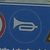

In [ ]:
# one more check
Image(filenames[673])

In [ ]:
labels_excel["TRAFFIC_SIGN"][673]

'COMPULSARY SOUND HORN'

since we've now got our training image path in a list, let's prepare our labels.

In [ ]:
# Getting labels corresponding to the filepaths 🟩
import numpy as np
labels = labels_excel['TRAFFIC_SIGN']
labels = np.array(labels)
labels

array(['ALL MOTOR VEHICLE PROHIBITED', 'ALL MOTOR VEHICLE PROHIBITED',
       'ALL MOTOR VEHICLE PROHIBITED', ..., 'Y INTERSECTION',
       'Y INTERSECTION', 'Y INTERSECTION'], dtype=object)

In [ ]:
len(labels)

7210

In [ ]:
# check if number of labels equals the number of filenames
if len(os.listdir("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/allmixjpg")) == len(labels) :
  print("Number of images equals the number of labels, Proceed")
else:
  print("Number of images is not equal to number of labels, check labels directory")  

Number of images equals the number of labels, Proceed


In [ ]:
# find the unique label values 🟩
unique_signs = np.unique(labels)
len(unique_signs)

85

In [ ]:
# turn a single label into array of boolean 🟩
print(labels[0])
labels[0] == unique_signs

ALL MOTOR VEHICLE PROHIBITED


array([ True, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False])

In [ ]:
# turn every label into a boolean array 🟩
boolean_labels = [label == unique_signs for label in labels]
boolean_labels[:2]

[array([ True, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False]),
 array([ True, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, Fal

In [ ]:
len(boolean_labels)

7210

In [ ]:
# Example: Turning boolean label into integer 🟩
print(labels[0]) # original label
print(np.where(unique_signs == labels[0]))  # index where label occurs
print(boolean_labels[0].argmax())  # index where label occurs in boolean array
print(boolean_labels[0].astype(int))  # there will be a 1 where sample label occures

ALL MOTOR VEHICLE PROHIBITED
(array([0]),)
0
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0]


## creating our own validation set



In [ ]:
# setup X and y variables 🟩
X = filenames
y = boolean_labels

In [ ]:
len(X)

7210

we are going to startoff experimentig with ~1000 images and increase as needed.

In [ ]:
# set number of images to use for experimenting 🟩
NUM_IMAGES = 4500 #@param {type:"slider", min:1000, max:5000, step:500}

In [ ]:
# let's split our data into train and validation sets 🟩
from sklearn.model_selection import train_test_split


#spliting them into training and validation of total size NUM_IMAGES
X_train,X_val,y_train,y_val = train_test_split(X[:NUM_IMAGES],
                                               y[:NUM_IMAGES],
                                               test_size=0.2,
                                               random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(3600, 3600, 900, 900)

## Preprocessing images (turning images to tensors)

to preprocess our images into tensors, we're going to write a function which does a few things:
1. Take an image filepath as input.
2. Use TensorFlow to read the file and save it into a variable, `image`.
3. Turn our `image` (a jpg) into Tensors.
4. Normalize the image (convert color channel values from 0-255 to 0-1)
4. Resize the `image` to be the shape of (224, 224)
5. Return the modified `image`.

Before we do, let's see what importing an array looks like.

✋✋✋ CHECK THE SHAPES OF OUR INPUT IMAGES ✋✋✋

In [ ]:
#convert image to NumPy array 🟩
from matplotlib.pyplot import imread
image = imread(filenames[102])
image.shape

(225, 340, 3)

In [ ]:
image[:2]

array([[[ 94, 165, 255],
        [ 91, 162, 252],
        [ 89, 160, 250],
        ...,
        [ 91, 162, 250],
        [ 93, 164, 252],
        [ 95, 166, 254]],

       [[ 93, 164, 254],
        [ 91, 162, 252],
        [ 89, 160, 250],
        ...,
        [ 91, 162, 250],
        [ 93, 164, 252],
        [ 94, 165, 253]]], dtype=uint8)

In [ ]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 340, 3), dtype=uint8, numpy=
array([[[ 94, 165, 255],
        [ 91, 162, 252],
        [ 89, 160, 250],
        ...,
        [ 91, 162, 250],
        [ 93, 164, 252],
        [ 95, 166, 254]],

       [[ 93, 164, 254],
        [ 91, 162, 252],
        [ 89, 160, 250],
        ...,
        [ 91, 162, 250],
        [ 93, 164, 252],
        [ 94, 165, 253]]], dtype=uint8)>

Now we have seen how an image looks as a Tensor, so now let's make a function to preprocess them.

✋✋✋ THE FOLLOWING FUNCTION `process_image()` TAKES IMAGE PATH, READ IMAGE, CONVERTS IT INTO A TENSOR WITH RGB CHANNEL, NORMALIZES IT, RESHAPE IT AND RETURNS A TENSOR  ✋✋✋

In [ ]:
# Define Image size 🟩
IMAGE_SIZE = 224

# create a function for preprocessing images
def process_image(image_path, img_size = IMAGE_SIZE):
  """
  takes an image file path and turns it into a Tensor
  """
  # read in an image file
  image = tf.io.read_file(image_path)

  # turn the jpg image into a tensor with 3 channel (RGB)
  image = tf.image.decode_jpeg(image, channels=3)

  # convert the color channel values from 0-255 to 0-1 (Normalization)
  image = tf.image.convert_image_dtype(image, tf.float32)

  # resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size= [img_size, img_size])

  return image
  

In [ ]:
image.shape

(225, 340, 3)

## Turning our data into batches🟪

why do we want to turn data into batches?

Let's say if we are working with 10000+ images in one go....they all might not fit into memory.

so that's why we do 32(batch size) images at a time. you can manually adjust the batch size if needed.

In order to use TensorFlow effectively, we need our data in the form of tensor tuples which looks like this:
`(image, label)` 

In [ ]:
# create a simple function to create a tuple (image, label) 🟩🟪
def get_image_label(image_path,label):
  """
  takes an imagepath and the associated label, processes the image and returns the tuple of (image,label)
  """
  image = process_image(image_path)
  return image,label 

In [ ]:
# demo of above function🟪
get_image_label(X[42],tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.98823535, 0.98823535, 0.98823535],
         [0.99021363, 0.99021363, 0.99021363],
         [0.9928397 , 0.9928397 , 0.9928397 ],
         ...,
         [0.98823535, 0.98823535, 0.98823535],
         [0.98823535, 0.98823535, 0.98823535],
         [0.98823535, 0.98823535, 0.98823535]],
 
        [[0.9921919 , 0.9921919 , 0.9921919 ],
         [0.9941702 , 0.9941702 , 0.9941702 ],
         [0.9964518 , 0.9964518 , 0.9964518 ],
         ...,
         [0.99021363, 0.99021363, 0.99021363],
         [0.99021363, 0.99021363, 0.99021363],
         [0.99021363, 0.99021363, 0.99021363]],
 
        [[0.9940302 , 0.9940302 , 0.9940302 ],
         [0.99600846, 0.99600846, 0.99600846],
         [0.99807054, 0.99807054, 0.99807054],
         ...,
         [0.9921569 , 0.9921569 , 0.9921569 ],
         [0.9921569 , 0.9921569 , 0.9921569 ],
         [0.9921569 , 0.9921569 , 0.9921569 ]],
 
        ...,
 
        [[0.9921569 , 0.9921569 

Now we got a way to turn our data into tuple of tensors in the form: `(image,label)` now lets make a function to turn all our data (`X` & `y`)into batches!!


In [ ]:
# define the batch size, 32 is a good start. 🟩
BATCH_SIZE = 32

# create a function to turn data into batches.
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  create batches of data out of image(X) and label(y) pairs.
  shuffles the data if its training data but doesnt shuffle if its validation data.
  Also accepts test data as input(no labels).
  """

  # if data is a test dataset, we probabily dont have labels.
  if test_data:
    print("creating test data batches....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X)))  #only filepaths with no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # if the data is valid dataset, we dont need to shuffle it.
  elif valid_data:
    print("Creating validation data batches....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),    #filepaths
                                               tf.constant(y)))   #labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch    

  else:
    print("Creating training data batches....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),    #filepaths
                                               tf.constant(y)))   #labels

    #shuffling pathnames and labels before mapping
    data = data.shuffle(buffer_size=len(X))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)  
    return data_batch                                                                         
                                                


In [ ]:
# creating training and validation data-batches
train_data = create_data_batches(X_train,y_train)
val_data = create_data_batches(X_val,y_val,valid_data=True)

Creating training data batches....
Creating validation data batches....


In [ ]:
# checkout different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 85), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 85), dtype=tf.bool, name=None)))

## Visualizing Data Batches
our data is in batches but it is still hard to understand so, let's visualize them.

In [ ]:
import matplotlib.pyplot as plt

#creating a function to visualise data batches
def show_25_images(images, labels):

  """
  Display a plot of 25 images with label from their data batch
  """
  #setup the figure
  plt.figure(figsize=(15,15))
  #loop through 25 (for displaying 25 images)
  for i in range(25):
    #create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    #display an image
    plt.imshow(images[i])
    # add the image label as title
    plt.title(unique_signs[labels[i].argmax()])
    # turn the gridlines off
    plt.axis("off")
  







In [ ]:
train_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 85)), types: (tf.float32, tf.bool)>

In [ ]:
train_images, train_labels =next(train_data.as_numpy_iterator())
len(train_images), len(train_labels)

(32, 32)

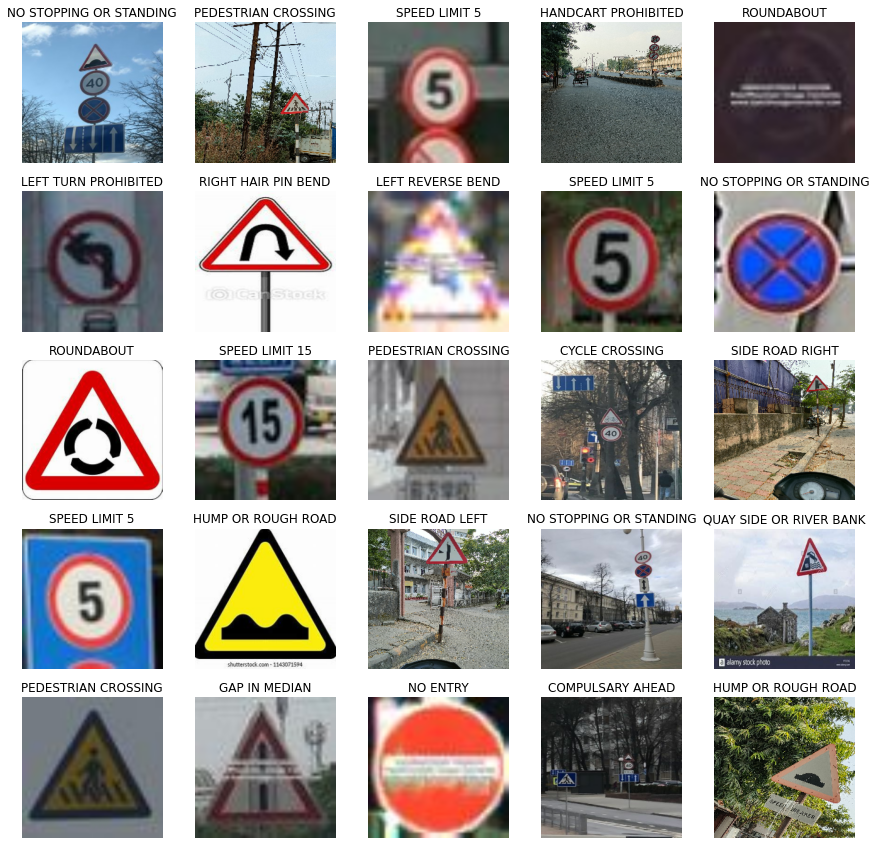

In [ ]:
#now lets visualize the data in a training batch
show_25_images(train_images, train_labels)

In [ ]:
# now let's visualise our validation set🟪
val_images, val_labels =next(val_data.as_numpy_iterator())
len(val_images), len(val_labels)

(32, 32)

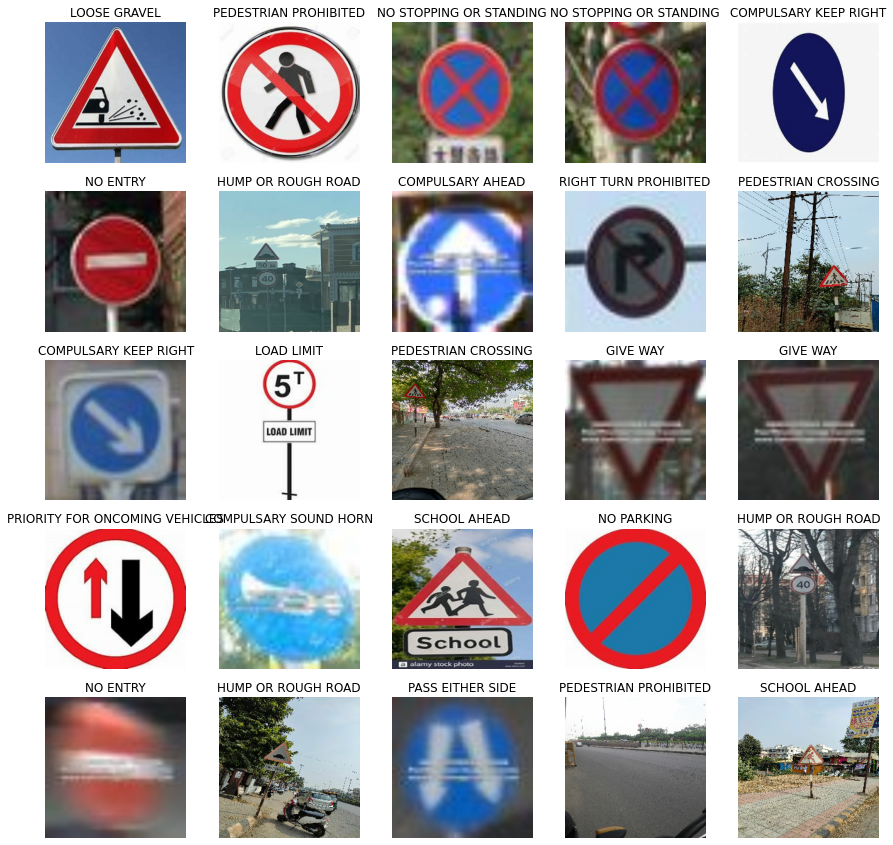

In [ ]:
show_25_images(val_images, val_labels)

## Building a model🟪

before we build a model, there are a few things that we need to define:
* The input shape (our images shape, in form of Tensors) to our model.
* The output shape (image labels, in form of Tensors) to our model.
* The URL of model we want to use from tensorflow Hub.link-https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
# setup input shape to the model
INPUT_SHAPE = [None, IMAGE_SIZE, IMAGE_SIZE, 3]

In [ ]:
# setup utput shape to the model
OUTPUT_SHAPE = len(unique_signs)

In [ ]:
# setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

Now we have got our Inputs, output and model ready. So, let's put them together in keras deep learning model!

Knowing this lets create a function which:
* Takes the input shape, output shape and the model we have chosen as parameter.
* Define the layers in a keras model in sequencial fashion.
(do this first, then this, then that)....
* compiles the model(says it should me evaluated and improved)
* Builds the model (tells the model what imput shape the model is getting)
* Returns the model.

All these steps can be found here- https://www.tensorflow.org/guide/keras/sequential_model

✋✋✋ THE FOLLOWING FUNCTION `create_model` BUILDS A KERAS MODEL ✋✋✋

In [ ]:
# Create a function which builds a keras model🟪
def create_model (input_shape =INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url= MODEL_URL):
  print("Building model with:",MODEL_URL)

  # setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL),  #layer1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation ="softmax")  #layer2 (output layer) 

  ])

  # Compile the model
  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

  

In [ ]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 85)                85170     
                                                                 
Total params: 5,517,883
Trainable params: 85,170
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callbacks🟪

Callbacks are the helper function that the model can use during training to do such things as save it's progress, check it's progress or stop training early if the model stops improving.

We will create two callbacks, one for the Tensorboard which helps track our model progress and another for early stoping which prevents our model from training for too long.

### TensorBoard callbacks
To setup atensorboard callback wew need to do 3 things-

1. Load the tensorboard notebook extension.
2. Create a tensorboard callback which is able to save logs to a directory and pass it to our model's `fit()` function.
3. Visualize our models training logs with `%tensorboard` magic function (we will do this after model training)


In [ ]:
# load tensor board notebook extension 
%load_ext tensorboard

In [ ]:
import datetime

# create a function to build a tensorboard callback
def create_tensorboard_callback ():
  # create a log directory for storing tensorboard logs
  logdir = os.path.join("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/logs",
                        #make it so the log gets tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(log_dir=logdir)

### early stoping callback

early stoping helps our model from overfitting by stopping training if a certain evaluation metric stops improving.  



In [ ]:
# create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  patience=3)

# Training a model (on subset of data)

our first model is only going to train on 1000 images, to make sure everything is working. 

In [ ]:
NUM_EPOCHS =  100 #@param {type:'slider',min:10,max:100,step:10}

In [ ]:
# check to makesure we are still running on a GPU
print("GPU", "available (YESSS!!)" if tf.config.list_physical_devices("GPU") else "Not Available :(" )

GPU available (YESSS!!)


Let's create a function which trains a model

* create a model using `create_model()`
* setup a TensorBoard callback using `create_tensorboard_callback()`
* call the fit function on our model passing it the training data, validation data, no. of epochs to train for (`NUM_EPOCHS()`) and the callbacks we would like to use
* return the model


In [ ]:
# build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # create a model
  model = create_model()

  # create a new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard,early_stopping])
  
  # return the fitted model
  return model

In [ ]:
# fit the model to the data 🟪
model = train_model()


Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
113/113 [==============================] - 824s 7s/step - loss: 2.1966 - accuracy: 0.4811 - val_loss: 1.3651 - val_accuracy: 0.6544
Epoch 2/100
113/113 [==============================] - 60s 533ms/step - loss: 0.9097 - accuracy: 0.7519 - val_loss: 1.0732 - val_accuracy: 0.7189
Epoch 3/100
113/113 [==============================] - 60s 533ms/step - loss: 0.6056 - accuracy: 0.8344 - val_loss: 0.9321 - val_accuracy: 0.7556
Epoch 4/100
113/113 [==============================] - 60s 531ms/step - loss: 0.4541 - accuracy: 0.8797 - val_loss: 0.9845 - val_accuracy: 0.7567
Epoch 5/100
113/113 [==============================] - 60s 529ms/step - loss: 0.3654 - accuracy: 0.9067 - val_loss: 0.9407 - val_accuracy: 0.7622
Epoch 6/100
113/113 [==============================] - 60s 532ms/step - loss: 0.3087 - accuracy: 0.9214 - val_loss: 0.8859 - val_accuracy: 0.7789
Epoch 7/100
113/113 [============

### Checking the TensorBoard Logs 🟪

The tensorboard magic function `%tensorboard` will access the logs directory which we created earlier and visualise its contents.

In [ ]:
%tensorboard --logdir drive/MyDrive/Colab\ Notebooks/traffic\ sign\ classification\ dataset/logs

Reusing TensorBoard on port 6006 (pid 396), started 0:00:17 ago. (Use '!kill 396' to kill it.)

<IPython.core.display.Javascript object>

## making and evaluating predictions using a trained model



In [ ]:
# make prediction on the validation data (not used to train on)
prediction = loaded_4500_image_model.predict(val_data, verbose=1)
#prediction = model.predict(val_data, verbose=1)
prediction


29/29 [==============================] - 102s 3s/step


array([[7.1893883e-05, 2.4422563e-06, 2.5790858e-03, ..., 2.4009371e-06,
        2.2946549e-06, 2.1919736e-06],
       [5.2541588e-03, 7.3033576e-03, 1.0104077e-06, ..., 6.4225793e-07,
        9.5869844e-08, 7.0530155e-07],
       [7.7246688e-11, 1.0101402e-10, 1.3520952e-11, ..., 6.7972706e-12,
        5.1656695e-12, 2.1005298e-12],
       ...,
       [1.3216926e-10, 2.5172366e-11, 2.4589822e-10, ..., 5.7040761e-12,
        2.7844233e-12, 6.2339613e-12],
       [1.1880108e-05, 2.9506842e-05, 1.7058570e-08, ..., 2.3959257e-09,
        9.5396873e-09, 5.9295213e-09],
       [4.5618208e-06, 2.4308056e-09, 4.6248688e-06, ..., 3.3395811e-10,
        1.0056014e-09, 2.8423752e-10]], dtype=float32)

In [ ]:
prediction.shape

(900, 85)

In [ ]:
prediction[0]

array([7.18938827e-05, 2.44225635e-06, 2.57908576e-03, 6.39923928e-06,
       4.08711639e-06, 6.22157753e-03, 4.38181560e-05, 6.16315674e-06,
       2.28429941e-04, 7.75436774e-07, 2.77475419e-06, 3.01503809e-04,
       8.50798733e-06, 2.43032787e-06, 1.06559639e-06, 1.98105299e-05,
       3.32092692e-04, 4.83602253e-06, 3.12680076e-03, 2.55280063e-02,
       5.42174712e-06, 5.55000093e-04, 2.13619260e-05, 1.34538636e-02,
       6.14541432e-06, 2.77480849e-05, 7.42415693e-07, 2.32320349e-03,
       3.47970927e-05, 2.28611939e-03, 5.19965106e-05, 4.13180515e-02,
       1.76313997e-03, 1.92544292e-04, 9.79408738e-04, 5.91924345e-06,
       3.75335621e-05, 6.14612327e-06, 4.48976345e-02, 1.80654097e-05,
       8.48246418e-05, 1.65029045e-03, 4.05430292e-05, 5.72842146e-05,
       9.04222034e-05, 3.60121194e-05, 1.83313389e-07, 8.03727657e-03,
       1.81121417e-04, 7.69111502e-04, 6.90698922e-02, 3.96818450e-07,
       6.20777979e-02, 1.47637722e-04, 2.51183566e-03, 4.95928049e-04,
      

In [ ]:
np.sum(prediction[0])

1.0

In [ ]:
# making prediction 🟪
index = 74
print(prediction[index])
print(f"Max value (probability of prediction): {np.max(prediction[index])}")
print(f"Sum: {np.sum(prediction[index])}")
print(f"Max Index: {np.argmax(prediction[index])}")
print(f"Predicted label: {unique_signs[np.argmax(prediction[index])]}")

[3.4416843e-08 4.4832939e-11 2.5663455e-08 4.1009049e-09 3.8218298e-07
 1.2756463e-08 1.8291310e-06 6.7992090e-08 2.9238571e-08 2.0137226e-07
 5.4202283e-06 1.5657685e-04 6.6843264e-09 3.7055464e-08 1.5747317e-05
 9.7600719e-09 8.5829233e-06 2.2918123e-08 2.9765475e-08 5.1573697e-06
 4.7120440e-07 9.1738245e-10 3.6819234e-08 9.9666293e-09 1.3345647e-09
 5.7977186e-08 4.0780842e-06 5.3951106e-07 2.9335922e-07 8.6454394e-10
 1.0310600e-04 2.8518120e-06 2.6029215e-10 1.7544156e-06 7.6789517e-09
 1.9859384e-04 1.6990396e-07 2.6546356e-09 6.6028866e-07 2.1338624e-06
 1.0451295e-08 5.9261577e-08 9.9508095e-01 1.6331085e-04 3.9723464e-03
 9.8002019e-08 4.5690498e-08 9.5976432e-08 1.5435006e-07 3.9992850e-07
 5.8828444e-08 1.6516145e-09 5.8429006e-08 1.4838994e-08 2.6550218e-08
 2.2583737e-04 1.9925524e-07 1.1138086e-06 1.3737811e-08 7.7987551e-07
 4.7282467e-10 6.5858217e-08 4.4698769e-05 9.8343424e-11 1.2933128e-08
 7.0192074e-10 5.4386385e-07 7.4472033e-11 1.0802482e-09 1.3325523e-10
 4.310

Having the above functionality is great but we want to do it at scale.
and it would be better if we could see the image on which the prediction is being made on.
NOTE- Prediction probabilities are also known as confidence levels.


In [ ]:
# Turning prediction probabilities into their respective labels(easier to understand) 
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_signs[np.argmax(prediction_probabilities)]

# get a predicted label based on an array of predicted probabilities
pred_label = get_pred_label(prediction[8])
pred_label

'RIGHT TURN PROHIBITED'

Now since our validation data is still in the batch dataset, we will have to unbatchify it to make prediction on the validation images and then compare those predictions to the validation labels(truth labels). 

In [ ]:
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 85)), types: (tf.float32, tf.bool)>

In [ ]:
# create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image,label) tensors and return seperate array of images and labels.
  """
  images = []
  labels = []

  #loop through unbatched data
  for image,label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_signs[np.argmax(label)])
  return images,labels

# unbatchify the validation data
val_images,val_labels = unbatchify(val_data)
val_images[0],val_labels[0] 


(array([[[0.34116772, 0.4705795 , 0.6823442 ],
         [0.34116772, 0.4705795 , 0.6823442 ],
         [0.34116772, 0.4705795 , 0.6823442 ],
         ...,
         [0.25097165, 0.38038343, 0.58822656],
         [0.24312852, 0.37254027, 0.5803834 ],
         [0.24312852, 0.37254027, 0.5803834 ]],
 
        [[0.33722866, 0.46664044, 0.6784051 ],
         [0.33722866, 0.46664044, 0.6784051 ],
         [0.33722866, 0.46664044, 0.6784051 ],
         ...,
         [0.24703258, 0.37644437, 0.58428746],
         [0.2392157 , 0.36862746, 0.5764706 ],
         [0.2392157 , 0.36862746, 0.5764706 ]],
 
        [[0.33333334, 0.46274513, 0.6745098 ],
         [0.33333334, 0.46274513, 0.6745098 ],
         [0.33333334, 0.46274513, 0.6745098 ],
         ...,
         [0.24304974, 0.3724615 , 0.5803046 ],
         [0.23917194, 0.36858368, 0.57642686],
         [0.23917194, 0.36858368, 0.57642686]],
 
        ...,
 
        [[0.43529415, 0.5803922 , 0.78823537],
         [0.43529415, 0.5803922 , 0.78823

Now we have got ways to get
* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's make a function to make this all a bit more visual

We will create a function which-
* takes an array of prediction probabilities, an array of truth labels, and an array of images and integers.
* convert the prediction probabilities to a predicted label.
* plot the predicted label, it's predicted probability, the truth label and the target image on a single plot.

In [ ]:
def plot_pred( prediction_probabilities, labels, images, n=1):
  """
  view the prediction, ground truth and image for the sample n
  """
  pred_prob, true_label, images = prediction_probabilities[n], labels[n], images[n]

  #get the pred labels
  pred_label = get_pred_label(pred_prob)

  #plot images and remove ticks
  plt.imshow(images)
  plt.xticks([])
  plt.yticks([])

  #change the colour of title depending on whether the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"  

  # change plot title to be predicted, probability of prediction and truth label
  plt.title("{} {:2.0f}% {}".format(pred_label,   
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color=color)

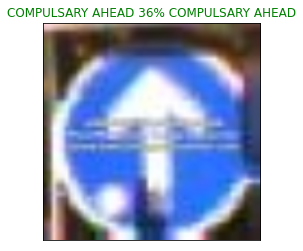

In [ ]:
plot_pred(prediction_probabilities=prediction,
          labels = val_labels,
          images = val_images,
          n=7)

Now we have got a function to get visualisation of top prediction, so now lets make a function to visualise top 10 prediction

this function will:
* Take an input of prediction probabilities array and a ground truth array and an integer
* Find the prediction using `get_pred_label()`
* Find the top 10: 
  * prediction probabilities indexes
  * prediction probabilities values
  * prediction labels
* plot the top 10 probability prediction values and labels, colouring the true label green  

In [ ]:
def plot_pred_conf (prediction_probabilities, labels, n=1):
  """
  plot the top 10 highest prediction confidences along with the true labels for sample n
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  #get the predicted label
  pred_label = get_pred_label(pred_prob)

  #find the top 10 prediction confidences indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  #find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  #find the top 10 prediction labels
  top_10_pred_labels = unique_signs[top_10_pred_indexes]

  #setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color = "grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  
  #change the color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass  

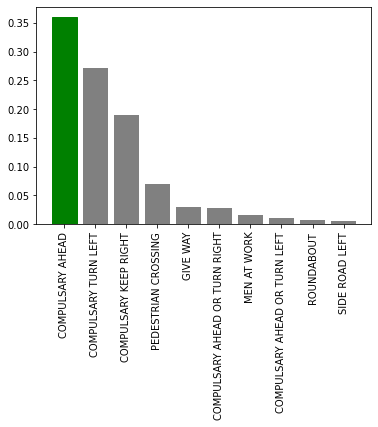

In [ ]:
plot_pred_conf(prediction_probabilities=prediction,
               labels = val_labels,
               n=7)

Now we have got some function to help us visualise the prediction and evaluate our model, lets us check a few

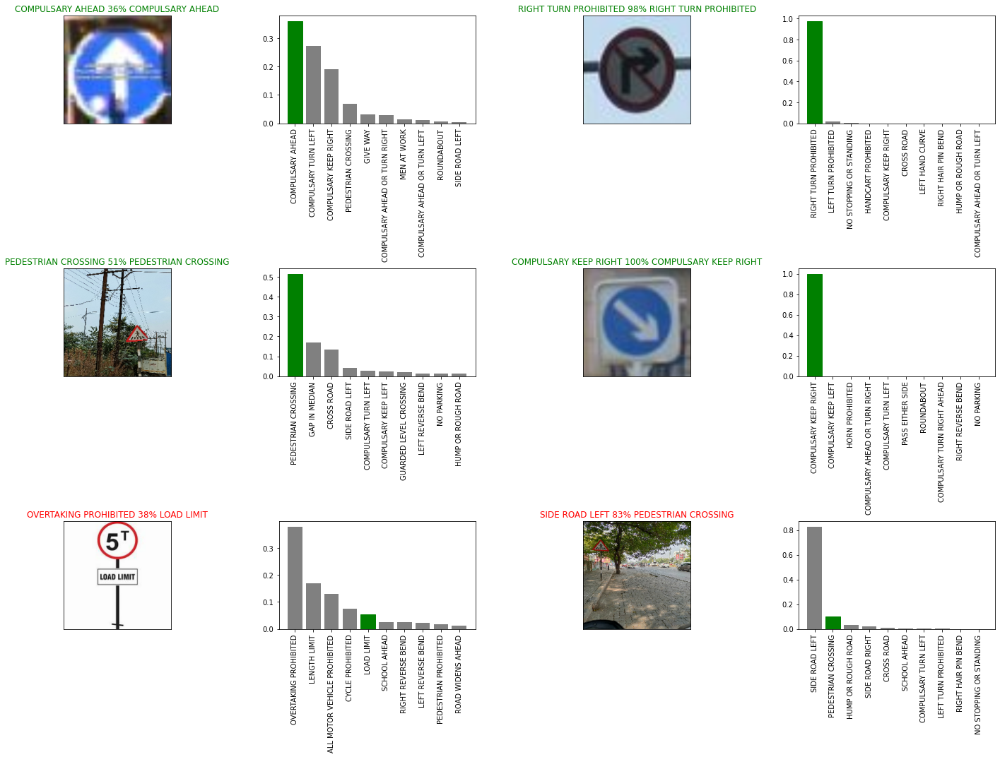

In [ ]:
#Let's checkout a few prediction and their different values  
i_multiplier = 7
num_rows = 3
num_cols = 2
num_images = num_cols*num_rows
plt.figure(figsize=(10*num_cols, 5*num_rows))

for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=prediction,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=prediction,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()


# Saving and reloading a trained model

In [ ]:
# Create a function to save a model
def save_model (model,suffix=None):
  """
  saves a given model in models directory and appends a suffix (string)
  """
  # Create a model dir3ectory pathname with current time
  modeldir = os.path.join("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models",
                          datetime.datetime.now().strftime("%y%m%d-%H%m%s"))
  model_path = modeldir + "-" + suffix + ".h5"
  print(f"Saving model to: {model_path}....")
  model.save(model_path)
  return model_path


In [ ]:
# Create a function to load a trained model 
def load_model (model_path):
  """
  load a saved model from a specified path
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

Now we have got a function to save and load a trained model, so let's make sure they work!

In [ ]:
# save our model trained on 1000 images
save_model(model, suffix="4500-images-19/11/2021-Mobilenetv2-Adam")

Saving model to: drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211119-10111637318866-4500-images-19/11/2021-Mobilenetv2-Adam.h5....


'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211119-10111637318866-4500-images-19/11/2021-Mobilenetv2-Adam.h5'

In [ ]:
# load a trained model
loaded_4500_image_model = load_model("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211119-10111637318866-4500-images-19/11/2021-Mobilenetv2-Adam.h5")

Loading saved model from: drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211119-10111637318866-4500-images-19/11/2021-Mobilenetv2-Adam.h5


In [ ]:
# evaluate the pre-saved model
model.evaluate(val_data)

29/29 [==============================] - 12s 414ms/step - loss: 0.9694 - accuracy: 0.7878


[0.9693889617919922, 0.7877777814865112]

In [ ]:
# evaluate the loaded model
loaded_4500_image_model.evaluate(val_data)

29/29 [==============================] - 12s 408ms/step - loss: 0.9694 - accuracy: 0.7878


[0.9693889617919922, 0.7877777814865112]

# Training the model on full dataset

In [ ]:
len(X),len(y)

(7210, 7210)

In [ ]:
# create a data batch with full data set
full_data = create_data_batches(X,y)

Creating training data batches....


In [ ]:
full_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 85)), types: (tf.float32, tf.bool)>

In [ ]:
# create a model for full model
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
# create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all the data, so we cannot monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

**Note:** running the cell below will take a little while because the GPU we are using will load all the images into the memory.

In [ ]:
#fit the full model to the full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
              callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
226/226 [==============================] - 518s 2s/step - loss: 2.0418 - accuracy: 0.4822
Epoch 2/100
226/226 [==============================] - 70s 310ms/step - loss: 0.9830 - accuracy: 0.7141
Epoch 3/100
226/226 [==============================] - 70s 310ms/step - loss: 0.7229 - accuracy: 0.7849
Epoch 4/100
226/226 [==============================] - 70s 309ms/step - loss: 0.5797 - accuracy: 0.8264
Epoch 5/100
226/226 [==============================] - 70s 307ms/step - loss: 0.4937 - accuracy: 0.8455
Epoch 6/100
226/226 [==============================] - 69s 306ms/step - loss: 0.4361 - accuracy: 0.8662
Epoch 7/100
226/226 [==============================] - 70s 308ms/step - loss: 0.3874 - accuracy: 0.8813
Epoch 8/100
226/226 [==============================] - 69s 306ms/step - loss: 0.3551 - accuracy: 0.8879
Epoch 9/100
226/226 [==============================] - 69s 306ms/step - loss: 0.3334 - accuracy: 0.8960
Epoch 10/100
226/226 [==============================] - 69s 307ms/

In [ ]:
save_model(full_model, suffix="full-image-set-18-11-2021-17:07-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211118-11111637235480-full-image-set-18-11-2021-17:07-mobilenetv2-Adam.h5....


'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211118-11111637235480-full-image-set-18-11-2021-17:07-mobilenetv2-Adam.h5'

In [ ]:
# load in the full model
loaded_full_model = load_model("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211118-11111637235480-full-image-set-18-11-2021-17:07-mobilenetv2-Adam.h5")

Loading saved model from: drive/MyDrive/Colab Notebooks/traffic sign classification dataset/models/211118-11111637235480-full-image-set-18-11-2021-17:07-mobilenetv2-Adam.h5


# Making prediction on the test dataset

since our model has been trained on images in the form of tensor batches, to make prediction on the test data, we will have to get it into same format.

Luckily, we have created `create_data_batches()` earlier which can take a list of filenames as input and convert them into tensor batches

To make prediction on the test data we will:
* get the test image filename
* convert the filenames into test data batches by using `create_data_batches()` and setting the `test_data` parameter to `True` (Since the test data doesn't have labels).
* make a predictions array by passing the test batches to the `predict()` method called on our model.


In [ ]:
# Load test image filenames
test_path = "drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image048.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image089.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image025.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image093.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image110 (2).jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image070.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image138 (2).jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image032.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image092.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/test_images/Image113 (2).jpg']

In [ ]:
len(test_filenames)

1969

In [ ]:
# create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

creating test data batches....


In [ ]:
test_data

<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

**Note:** calling `predict()` on our full model and passing it to test data batch will take a long time to run

In [ ]:
test_predictions = loaded_full_model.predict(test_data, verbose=1)

 5/62 [=>............................] - ETA: 2:16

KeyboardInterrupt: ignored

In [ ]:
# save prediction (numpy array) as csv file
np.savetxt("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/preds_array.csv", test_predictions, delimiter=",")


In [ ]:
#Load predictions from csv file
test_predictions = np.loadtxt("drive/MyDrive/Colab Notebooks/traffic sign classification dataset/preds_array.csv", delimiter=",")

In [ ]:
test_predictions.shape

In [ ]:
#create a pandas dataframe with empty columns
preds_df = pd.DataFrame(columns=["name"] + list(unique_signs))
preds_df.head()

In [ ]:
#append test image names to predictions dataframe
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df["name"] = test_ids

In [ ]:
preds_df.head()

In [ ]:
# add the prediction probabilities to the predictions dataframe
preds_df[list(unique_signs)] = test_predictions
preds_df.head()

# Making predictions on any custom images

To make prediction on custom images we will-

* Get the filepaths of our own images.
* Turn the filepaths into data batches using `create_data_batches()` and since our images won't be having labels we will set `test_data` parameter to `True`.
* Pass the custom image data batch to our models `predict()` method.
* Convert the prediction probabilities to prediction labels.
* Compare the predicted labels to the custom images.

In [ ]:
# Get custom image filepath
custom_path = "drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/"
custom_images_path = [custom_path + fname for fname in os.listdir(custom_path)]
custom_images_path

['drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116123443.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116123319.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116123233.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116123119.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116122912.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116122727.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116122623.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116122354.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign classification dataset/custom_images/IMG20211116122013.jpg',
 'drive/MyDrive/Colab Notebooks/traffic sign c

In [ ]:
# Turn custom images into batch dataset
custom_data = create_data_batches(custom_images_path, test_data=True)
custom_data

creating test data batches....


<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
# Make prediction on the custom data
custom_preds = loaded_full_model.predict(custom_data)
custom_preds.shape

(36, 85)

In [ ]:
# Get custom image prediction label
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['NO PARKING',
 'SIDE ROAD LEFT',
 'SIDE ROAD LEFT',
 'SIDE ROAD RIGHT',
 'GAP IN MEDIAN',
 'HORN PROHIBITED',
 'SIDE ROAD LEFT',
 'SIDE ROAD LEFT',
 'T INTERSECTION',
 'SCHOOL AHEAD',
 'GAP IN MEDIAN',
 'PEDESTRIAN CROSSING',
 'CROSS ROAD',
 'NO PARKING',
 'PEDESTRIAN CROSSING',
 'SCHOOL AHEAD',
 'SPEED LIMIT 20',
 'NO PARKING',
 'PEDESTRIAN CROSSING',
 'HORN PROHIBITED',
 'HUMP OR ROUGH ROAD',
 'CROSS ROAD',
 'CROSS ROAD',
 'NO PARKING',
 'NO PARKING',
 'SCHOOL AHEAD',
 'PEDESTRIAN CROSSING',
 'PEDESTRIAN CROSSING',
 'CROSS ROAD',
 'PEDESTRIAN CROSSING',
 'SCHOOL AHEAD',
 'PEDESTRIAN CROSSING',
 'CROSS ROAD',
 'CROSS ROAD',
 'PEDESTRIAN CROSSING',
 'CROSS ROAD']

In [ ]:
#
custom_images = []
# Look through unbatchified data
for image in custom_data.unbatch().as_numpy_iterator() :
  custom_images.append(image)

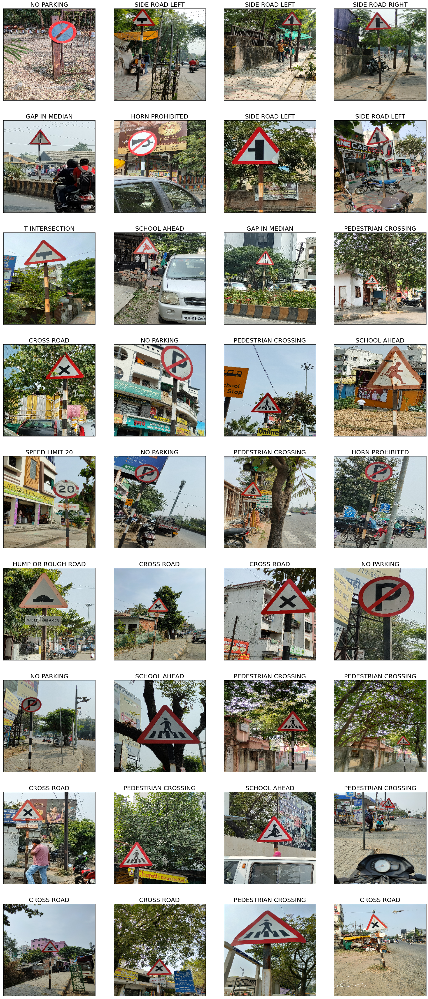

In [ ]:
# Check custom image prediction
plt.figure(figsize=(25,60))
for i, image in enumerate(custom_images):
  plt.subplot(9, 4, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i], fontsize=20)
  plt.imshow(image)